In [14]:
import os
import pandas as pd
import sys
import numpy as np
import math
from scipy.signal import resample
import matplotlib.pyplot as plt
# import utils.signalProcessing as signalutil
# import utils.fileProcessing as fileutil

sys.path.append(os.path.dirname(os.getcwd())) #Add project dir to path
from utils.syncUtilities import plotFramesShiftToSyncrhonizeAllSubjectsOneActivity,getMainJointFromMotAndMainBonesFromCSV, getSamplesToSynchronize, SynchronizeAndCutSignals
from utils.syncUtilities import FramesShift, FramesShift2, FramesShift3

import utils.fileProcessing as fileutil 
import utils.plotUtilities as plotutil
import utils.signalProcessing as signalutil

In [15]:
fulldatasetpath = '/Volumes/Data_Drive/datasets/VIDIMU'
infopath = os.path.join(fulldatasetpath,'analysis','videoandimusync')
inpath = os.path.join(fulldatasetpath,'dataset','videoandimusync')
croppath = os.path.join(fulldatasetpath,'dataset','videoandimusyncrop')

In [16]:
df_info = pd.read_csv(os.path.join(infopath, 'infoToSync.csv')).sort_values(by=['Subject', 'Activity'])
df_info.to_csv(os.path.join(infopath, 'infoToSync.csv'), index=False)
df_info = pd.read_csv(os.path.join(infopath, 'infoToSync.csv'))

In [17]:
subjects = ["S40","S41","S42",  "S44",  "S46","S47","S48","S49",
            "S50","S51","S52","S53","S54","S55","S56","S57"]

lower_activities = ["A01","A02","A03","A04"]
upper_activities = ["A05","A06","A07","A08","A09","A10","A11","A12","A13"]

dataset_activities = lower_activities + upper_activities

activities_legend = ["walk_forward", "walk_backward", "walk_along","sit_to_stand",
"move_right_arm","move_left_arm","drink_right_arm","drink_left_arm", "assemble_both_arms","throw_both_arms",
"reachup_right_arm","reachup_left_arm","tear_both_arms"]

motsignals_range = {
    'knee_angle_r':(-20,120),
    'knee_angle_l':(-20,120),
    'arm_flex_r':(-90,180),
    'elbow_flex_r':(-10,180),
    'arm_flex_l':(-90,190),
    'elbow_flex_l':(-10,190),
}

In [18]:
def mot_df(motpth):
    # Initialize a list to store the header
    header = []
    
    # Open the file and manually read the header lines
    with open(motpth, 'r') as f:
        for i, line in enumerate(f):
            # Stop reading the header at the data section (after 6th line)
            if i < 6:
                header.append(line.strip())  # Append each header line
            else:
                break
    
    # Now read the data part of the .mot file, skipping the first 6 lines (the header)
    df = pd.read_csv(motpth, sep='\s+', comment='#', header=6)  # Adjust `header=6` based on the file structure
    
    return df, header

<>:15: SyntaxWarning: invalid escape sequence '\s'
<>:15: SyntaxWarning: invalid escape sequence '\s'
/var/folders/fp/1nfx148n1js1jxdspmc7mb9r0000gn/T/ipykernel_5771/2177869853.py:15: SyntaxWarning: invalid escape sequence '\s'
  df = pd.read_csv(motpth, sep='\s+', comment='#', header=6)  # Adjust `header=6` based on the file structure


In [19]:
def write_mot_file(df, header, filepath):
    # Open the file in write mode
    with open(filepath, 'w') as f:
        # Step 1: Write the header lines
        for line in header:
            f.write(line + '\n')  # Ensure each header line is followed by a newline
        
        # Step 2: Write the column headers from the DataFrame
        f.write('\t'.join(df.columns) + '\n')  # Write the DataFrame column names as the header
        
        # Step 3: Write the data from the DataFrame
        for row in df.itertuples(index=False, name=None):
            # Apply custom formatting for each value in the row
            row_str = '\t'.join(format_value(val) for val in row)
            f.write(row_str + '\n')

def format_value(val):
    """
    Custom formatting function to match the original .mot file precision.
    - If the value is a float, retain 12 significant digits for the float.
    - If the value is essentially an integer (like 0), don't display decimal places.
    """
    if isinstance(val, float):
        if val.is_integer():  # If the float is essentially an integer, return it without decimal places
            return f'{int(val)}'
        else:  # Return with a specific precision (up to 12 significant digits to match the original)
            return f'{val:.12f}'.rstrip('0').rstrip('.')  # Stripping trailing zeros and unnecessary dots
    else:
        return str(val)

def validate_mot_file(original_filepath, output_filepath, tolerance=1e-6):
    """
    Compare the original .mot file with the output file, allowing for floating-point differences up to the specified tolerance.
    """
    with open(original_filepath, 'r') as original_file, open(output_filepath, 'r') as output_file:
        original_lines = original_file.readlines()
        output_lines = output_file.readlines()

        # Check if the number of lines matches
        if len(original_lines) != len(output_lines):
            print(f"Files have different numbers of lines. Original: {len(original_lines)}, Output: {len(output_lines)}")
            return False

        # Iterate line by line and compare
        for i, (orig_line, out_line) in enumerate(zip(original_lines, output_lines)):
            # Split each line into individual values (assuming tab separation)
            orig_values = orig_line.strip().split('\t')
            out_values = out_line.strip().split('\t')

            if len(orig_values) != len(out_values):
                print(f"Line {i+1} has different numbers of columns. Original: {len(orig_values)}, Output: {len(out_values)}")
                return False

            # Compare each value in the line
            for j, (orig_val, out_val) in enumerate(zip(orig_values, out_values)):
                try:
                    orig_float = float(orig_val)
                    out_float = float(out_val)
                    
                    # Compare floats with tolerance
                    if not math.isclose(orig_float, out_float, abs_tol=tolerance):
                        print(f"Difference found on line {i+1}, column {j+1}:")
                        print(f"Original: {orig_val}, Output: {out_val}")
                        return False
                except ValueError:
                    # If the value cannot be converted to float, compare them as strings (for headers or other non-float values)
                    if orig_val != out_val:
                        print(f"Difference found on line {i+1}, column {j+1}:")
                        print(f"Original: {orig_val}, Output: {out_val}")
                        return False

    print("The files match within the specified tolerance.")
    return True

#### Validation ####

# # File paths
# motpth = '/Volumes/Data_Drive/datasets/VIDIMU/dataset/videoandimusync/S40/ik_S40_A03_T02.mot'
# output_filepath = '/Users/niccolomeniconi/Desktop/Capstone/data_processing/junk/output_ik_S40_A03_T02.mot'

# # Step 1: Extract the DataFrame and header from the original .mot file
# imu_df, head = mot_df(motpth)

# # Step 2: Write the new .mot file
# write_mot_file(imu_df, head, output_filepath)

# # Step 3: Validate if the output file matches the original
# is_identical = validate_mot_file(motpth, output_filepath)

# if is_identical:
#     print("Validation successful: The output file matches the original.")
# else:
#     print("Validation failed: The output file differs from the original.")


In [20]:
def raw_df(pth):
    df = pd.read_csv(pth, sep=',', header=0)
    # Step 1: Create new columns for each quaternion
    df['quaternion_w'] = df['QUAT'] + '_w'
    df['quaternion_x'] = df['QUAT'] + '_x'
    df['quaternion_y'] = df['QUAT'] + '_y'
    df['quaternion_z'] = df['QUAT'] + '_z'
    
    # Step 2: Set the timestamp as the index, but keep it as a column for grouping
    df.reset_index(inplace=True)

    # Step 3: Reshape the dataframe - pivot the quaternion data
    # Prepare the data by reshaping it based on the 'label' and 'timestamp'
    df_pivot_w = df.pivot(index='timestamp', columns='quaternion_w', values='w')
    df_pivot_x = df.pivot(index='timestamp', columns='quaternion_x', values='x')
    df_pivot_y = df.pivot(index='timestamp', columns='quaternion_y', values='y')
    df_pivot_z = df.pivot(index='timestamp', columns='quaternion_z', values='z')

    # Step 4: Combine the pivoted dataframes
    df_final = pd.concat([df_pivot_w, df_pivot_x, df_pivot_y, df_pivot_z], axis=1)
    
    # Reset the index so that timestamp is the first column again
    df_final.reset_index(inplace=True)
    
    return df_final    
    
# raw_file = raw_df('/Volumes/Data_Drive/datasets/VIDIMU/dataset/videoandimusync/S40/S40_A03_T02.raw')
# len(raw_file['timestamp'].unique())

In [22]:
def crop_dfs(df_imu, df_vid):
    # Calculate the minimum duration in seconds between the two datasets
    min_duration = min(len(df_imu) / 50, len(df_vid) / 30)
    
    # Calculate the number of rows to retain in both DataFrames
    imu_rows = int(round(min_duration * 50))  # Number of IMU samples at 50Hz
    vid_rows = int(round(min_duration * 30))  # Number of Video samples at 30Hz
    
    # Crop the DataFrames to match the time duration
    df_imu_cropped = df_imu.iloc[:imu_rows]  # Crop IMU data
    df_vid_cropped = df_vid.iloc[:vid_rows]  # Crop Video data
    
    return df_imu_cropped, df_vid_cropped


def validate_cropped_signals(df_imu, df_vid):
    # Calculate durations
    duration_imu = len(df_imu) / 50  # IMU signal sampled at 50 Hz
    duration_vid = len(df_vid) / 30  # Video signal sampled at 30 Hz
    
    # Tolerance for time difference
    tolerance = 1.5e-2  # Tolerance of 15 milliseconds
    
    # Calculate the difference in durations
    time_difference = abs(duration_imu - duration_vid)
    
    # Check if the difference is within tolerance
    if time_difference < tolerance:
        print("The signals are approximately the same length.")
    else:
        print(f"Warning: The signals differ in length by {time_difference:.4f} seconds.")
    
    # Print the durations for reference
    print(f"Duration of IMU signal: {duration_imu:.4f} seconds")
    print(f"Duration of Video signal: {duration_vid:.4f} seconds")
    

In [23]:
## Check alignment and crop files###

for activity in dataset_activities:
    print("Activity: " + activity)
    for subj in subjects:
        print('\tSubject:', subj)
        for trial in ["T01", "T02", "T03", "T04", "T05"]:
            vidpth = os.path.join(inpath, subj, subj + '_' + activity + '_' + trial + '.csv')
            imupth = os.path.join(inpath, subj, 'ik_' + subj + '_' + activity + '_' + trial + '.mot')

            vid_exists = os.path.exists(vidpth)
            imu_exists = os.path.exists(imupth)

            if not vid_exists and not imu_exists:
                # print(f'\t\tNo files found for {subj}, {activity}, {trial}')
                continue


            # Continue with loading data if files exist
            if imu_exists:
                imu_df, imu_head = mot_df(imupth)
                # imu_df = raw_df(imupth)
            if vid_exists:
                vid_df = pd.read_csv(vidpth)

            if imu_exists and vid_exists:

                mycrop = True
                if mycrop:
                    imu_df, vid_df = crop_dfs(imu_df, vid_df)
                    write_mot_file(imu_df, imu_head, os.path.join(croppath, subj, 'ik_' + subj + '_' + activity + '_' + trial + '.mot'))
                    vid_df.to_csv(os.path.join(croppath, subj, subj + '_' + activity + '_' + trial + '.csv'))

            validate_cropped_signals(imu_df, vid_df)


Activity: A01
	Subject: S40
The signals are approximately the same length.
Duration of IMU signal: 36.3000 seconds
Duration of Video signal: 36.3000 seconds
	Subject: S41
The signals are approximately the same length.
Duration of IMU signal: 37.0800 seconds
Duration of Video signal: 37.0667 seconds
	Subject: S42
The signals are approximately the same length.
Duration of IMU signal: 41.7000 seconds
Duration of Video signal: 41.7000 seconds
	Subject: S44
The signals are approximately the same length.
Duration of IMU signal: 54.8400 seconds
Duration of Video signal: 54.8333 seconds
	Subject: S46
The signals are approximately the same length.
Duration of IMU signal: 31.0600 seconds
Duration of Video signal: 31.0667 seconds
	Subject: S47
The signals are approximately the same length.
Duration of IMU signal: 53.3600 seconds
Duration of Video signal: 53.3667 seconds
	Subject: S48
The signals are approximately the same length.
Duration of IMU signal: 48.1000 seconds
Duration of Video signal: 4

# Plot Synched Files

In [24]:
def plotFramesShiftToSyncrhonizeAllSubjectsOneActivity(csvlog,inpath,outpath,subjects,activity,activity_legend,outputfilename=None,RMSE_SAMPLES=200,MAX_SYNC_OVERLAP=15,FINAL_LENGTH=None):
    ncols = 5
    nrows = len(subjects)


    fig,axes=plt.subplots(nrows,ncols,figsize=(ncols*6,nrows*3))
    plt.rc('axes', titlesize=15)
    plt.rc('axes', labelsize=12)
    plt.rc('xtick', labelsize=12)
    plt.rc('ytick', labelsize=12)
    plt.rc('legend', fontsize=12)

    rmse_list =[]
    for i,subject in enumerate(subjects):

        dfmot = None
        dfcsv = None

        # 1) Load/compute imu and video joint's angle signals
        #Try to open the first existing trial for that subject

        for trial in ["T01","T02","T03","T04","T05"]:
            motsubjacttrial = subject+"_"+activity+"_"+trial
            motfilename = 'ik_'+motsubjacttrial+".mot"
            inpathmotfull = os.path.join(inpath,subject,motfilename)
            if not os.path.exists(inpathmotfull):
                continue
            else:
                folder = os.path.join(inpath,subject)
                #print("READING: "+inpathmotfull[:-4])
                dfmot,dfcsv = fileutil.readMOTandCSV(folder,subject,activity,trial)
                break #limit to the first existing trial
        if dfmot is None or dfcsv is None:
            print("Not found")
            continue

        jointMot,bonesCSV=getMainJointFromMotAndMainBonesFromCSV(dfmot,dfcsv,activity)
        jointangle_imus = fileutil.getJointAngleMotAsNP(dfmot,jointMot)
        jointangle_video = fileutil.getJointAngleCsvAsNP(bonesCSV)
      
        # 2) Downsample imu to 30 fps and interpolate video (remove zeros)
        jointangle_video_inter = signalutil.fill_nan(jointangle_video)
        jointangle_imus_cutdown = signalutil.downsampleSignal(jointangle_imus,50,30)
        # 3) Smooth both signals
        jointangle_imus_cutfilt = signalutil.applyMovingAverageFilter(jointangle_imus_cutdown)
        jointangle_video_cutfilt = signalutil.applyMovingAverageFilter(jointangle_video_inter)
        
        # 4) Compute RMSE of signals
        SUBARRAY_SAMPLES = RMSE_SAMPLES+MAX_SYNC_OVERLAP
        try:
            rmse_smooth=signalutil.calcRMSE(jointangle_imus_cutfilt[:RMSE_SAMPLES],jointangle_video_cutfilt[:RMSE_SAMPLES])
        except Exception as e:
            print(f'Error for activity {activity}, subject {subject}, trial {trial} at step 4: \n{e}')
            continue            
        # 5) Center signals in mean for better synchronization
        jointangle_imus_centered=signalutil.centerSignalInMean(jointangle_imus_cutfilt,samples=SUBARRAY_SAMPLES)
        jointangle_video_centered=signalutil.centerSignalInMean(jointangle_video_cutfilt,samples=SUBARRAY_SAMPLES)
        rmse_centered=signalutil.calcRMSE(jointangle_imus_centered[:RMSE_SAMPLES],jointangle_video_centered[:RMSE_SAMPLES])
      
        # 6) Shift and cut signals to find ideal synchronization 
        try:
            rmse_original,remove_samples_imu,minimum_rmse_imu,bool_cut_imu,\
            remove_samples_video,minimum_rmse_video,bool_cut_video=getSamplesToSynchronize(
                                                                jointangle_imus_centered,
                                                                jointangle_video_centered,
                                                                maxshift=MAX_SYNC_OVERLAP,
                                                                fitlength=RMSE_SAMPLES)
        except Exception as e:
            print(f'Error for activity {activity}, subject {subject}, trial {trial} at step 6: \n{e}')
            continue
        if bool_cut_imu:
            rm_samples_imu_minrmse=remove_samples_imu
            rm_samples_video_minrmse=0    
        elif bool_cut_video:
            rm_samples_imu_minrmse=0
            rm_samples_video_minrmse=remove_samples_video
        else:
            rm_samples_imu_minrmse=0
            rm_samples_video_minrmse=0

        if FINAL_LENGTH is None:
            print("IMUS: ",len(jointangle_imus_centered),rm_samples_imu_minrmse)
            print("VIDEO: ",len(jointangle_video_centered),rm_samples_video_minrmse)
            FINAL_LENGTH=min(len(jointangle_imus_centered)-rm_samples_imu_minrmse,len(jointangle_video_centered)-rm_samples_video_minrmse)
            print(FINAL_LENGTH)
        jointangle_imus_shift, jointangle_video_shift,rmse_shift = SynchronizeAndCutSignals(
                                                            jointangle_imus_centered,
                                                            jointangle_video_centered,
                                                            rm_samples_imu_minrmse,
                                                            rm_samples_video_minrmse,
                                                            max_length=FINAL_LENGTH)

        #rmse_shift_real=signalutil.calcRMSE(jointangle_imus_shift[:RMSE_SAMPLES],jointangle_video_shift[:RMSE_SAMPLES])

        rmse_list.append(rmse_shift)
        yaxis0=motsignals_range[jointMot][0]
        yaxis1=motsignals_range[jointMot][1]
        
        # for j in range(ncols):
        #     if j == 0:
        #         color = 'r'
        #         imujoint=jointMot
        #         X=np.arange(0,jointangle_imus.shape[0])
        #         axes[i][j].set_ylim([yaxis0, yaxis1])
        #         axes[i][j].plot(X,jointangle_imus,color)
        #         axes[i][j].set_title(motsubjacttrial+'.mot' + ' (Angle: '+str(imujoint)+')')
        #         axes[i][j].set_xlabel("")
        #         axes[i][j].set_ylabel("Degrees")
        #         axes[i][j].set_xlabel("Samples (50 Hz)")
        #     if j==1:
        #         color = 'b'
        #         X=np.arange(0,jointangle_video_cutfilt.shape[0])
        #         axes[i][j].set_ylim([yaxis0, yaxis1])
        #         axes[i][j].plot(X,jointangle_video_cutfilt,color)
        #         axes[i][j].set_title(motsubjacttrial+'.csv' + " (Angle: estimated)")
        #         axes[i][j].set_ylabel("Degrees")
        #         axes[i][j].set_xlabel("Samples (30 Hz)")
        
        for j in range(ncols):
            if j == 0:
                color = 'r'
                imujoint = jointMot
                X = np.arange(0, jointangle_imus.shape[0])
                axes[i][j].set_ylim([yaxis0, yaxis1])
                axes[i][j].plot(X, jointangle_imus, color)
                # Add two lines to the title
                axes[i][j].set_title(f'{motsubjacttrial}.mot (Angle: {str(imujoint)})\n'
                                    f'Length of original file: {len(dfmot)}\n'
                                    f'Time length: {jointangle_imus.shape[0]/50:.2f}\n'
                                    )
                axes[i][j].set_xlabel("")
                axes[i][j].set_ylabel("Degrees")
                axes[i][j].set_xlabel("Samples (50 Hz)")
            
            if j == 1:
                color = 'b'
                X = np.arange(0, jointangle_video_cutfilt.shape[0])
                axes[i][j].set_ylim([yaxis0, yaxis1])
                axes[i][j].plot(X, jointangle_video_cutfilt, color)
                # Add two lines to the title
                axes[i][j].set_title(f'{motsubjacttrial}.csv (Angle: estimated)\n'
                                    f'Length of original file: {len(dfcsv)}\n'
                                    f'Time length: {jointangle_video.shape[0]/30:.2f}\n'
                                    )
                axes[i][j].set_ylabel("Degrees")
                axes[i][j].set_xlabel("Samples (30 Hz)")
            if j==2:
                X=np.arange(0,RMSE_SAMPLES)
                axes[i][j].set_ylim([yaxis0, yaxis1])
                axes[i][j].plot(X,jointangle_imus_cutfilt[:RMSE_SAMPLES],color='r',label='imus')
                axes[i][j].plot(X,jointangle_video_cutfilt[:RMSE_SAMPLES],color='b',label='video')
                axes[i][j].set_title("SMOOTHED, RMSE: {:.2f}".format(rmse_smooth))
                axes[i][j].set_ylabel("Degrees")
                axes[i][j].set_xlabel("Samples (30 Hz)")
                axes[i][j].legend()
            if j==3:
                X=np.arange(0,RMSE_SAMPLES)
                axes[i][j].set_ylim([-(yaxis1-yaxis0)/2, (yaxis1-yaxis0)/2])                
                axes[i][j].plot(X,jointangle_imus_centered[:RMSE_SAMPLES],color='r',label='imus')
                axes[i][j].plot(X,jointangle_video_centered[:RMSE_SAMPLES],color='b',label='video')
                axes[i][j].set_title("MEAN REMOVAL, RMSE: {:.2f}".format(rmse_centered))
                axes[i][j].set_xlabel("")
                axes[i][j].set_ylabel("Degrees")
                axes[i][j].set_xlabel("Samples (30 Hz)")
                axes[i][j].legend()

            if j==4:
                X=np.arange(0,FINAL_LENGTH)
                axes[i][j].set_ylim([-(yaxis1-yaxis0)/2, (yaxis1-yaxis0)/2])                
                axes[i][j].plot(X,jointangle_imus_shift[:FINAL_LENGTH],color='r',label='imus')
                axes[i][j].plot(X,jointangle_video_shift[:FINAL_LENGTH],color='b',label='video')
                axes[i][j].set_title("SHIFTED, RMSE: {:.2f} ".format(rmse_shift)+" (cut imu:"+str(rm_samples_imu_minrmse)+", cut vid:"+str(rm_samples_video_minrmse)+")")
                axes[i][j].set_xlabel("")
                axes[i][j].set_ylabel("Degrees")
                axes[i][j].set_xlabel("Samples (30 Hz)")
                axes[i][j].legend()



    title="Activity "+activity+": "+activity_legend+ " (one subject per row)"
    plt.suptitle(title,fontsize=18, verticalalignment='top',y=1.0)
    plt.tight_layout(pad=1.0, h_pad=1.0, w_pad=1.0)
    if outputfilename:
        plt.savefig(os.path.join(outpath,outputfilename+'.svg'),format='svg')
        plt.savefig(os.path.join(outpath,outputfilename+'.pdf'),format='pdf')
        # #plt.savefig(os.path.join(outpath,outputfilename+'.png'),format='png',dpi=600)
    plt.show()
    return rmse_list

In [25]:
print(croppath)

/Volumes/Data_Drive/datasets/VIDIMU/dataset/videoandimusyncrop


Activity: A01


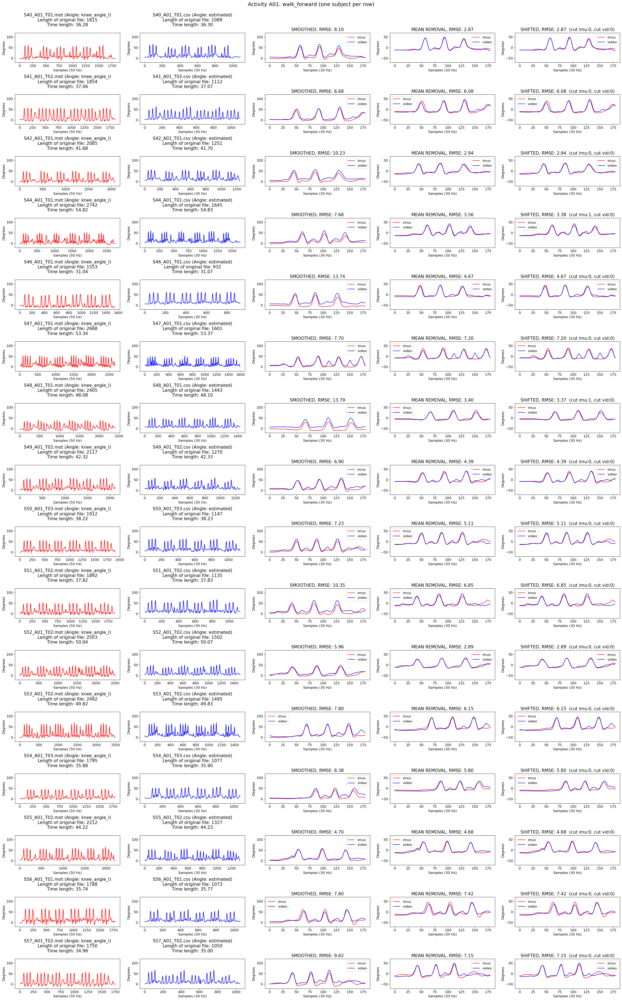

Activity: A02


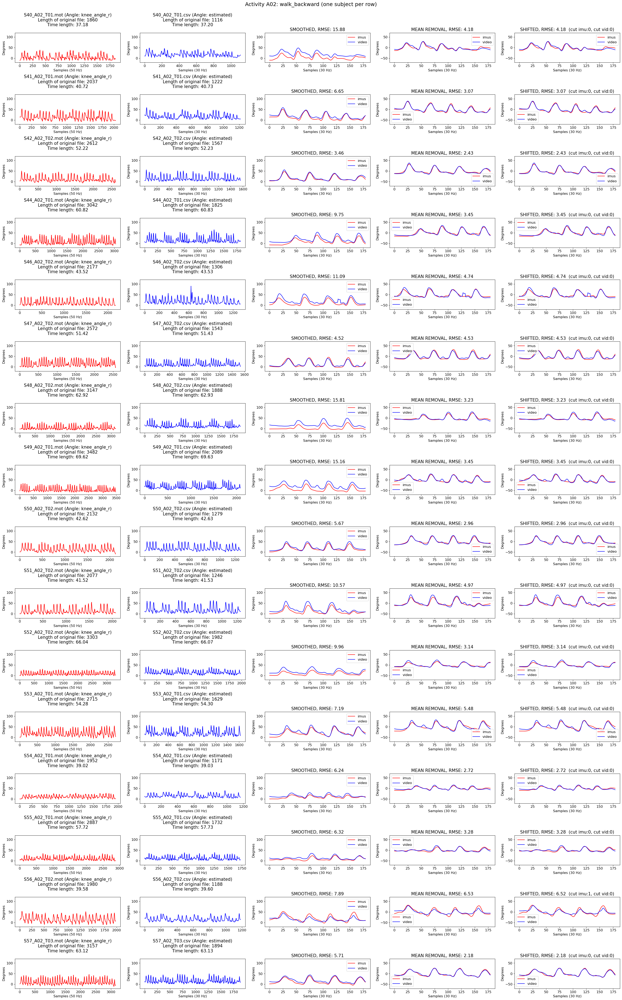

Activity: A03


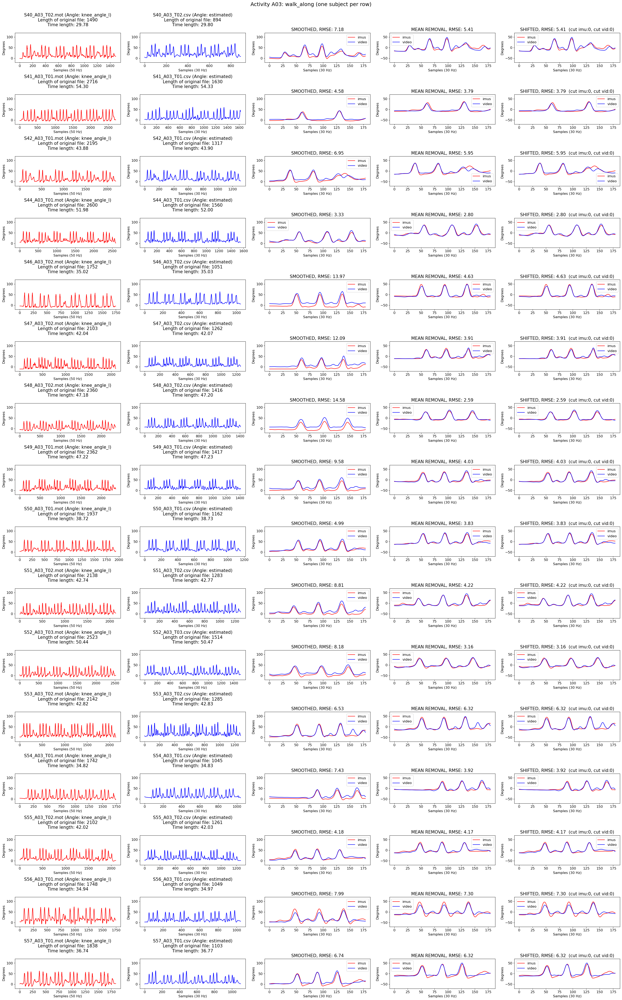

Activity: A04


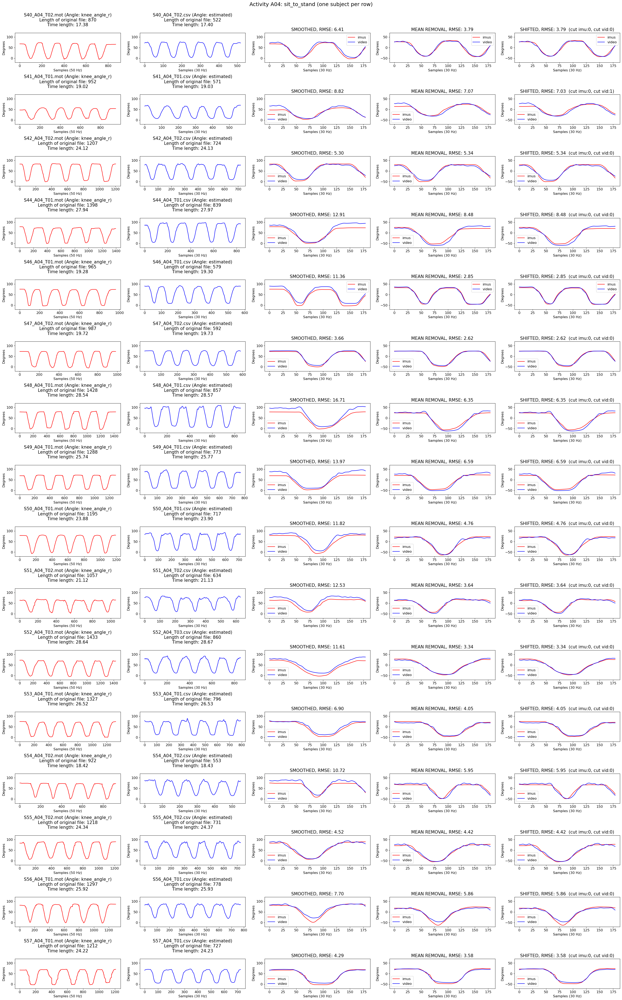

Activity: A05


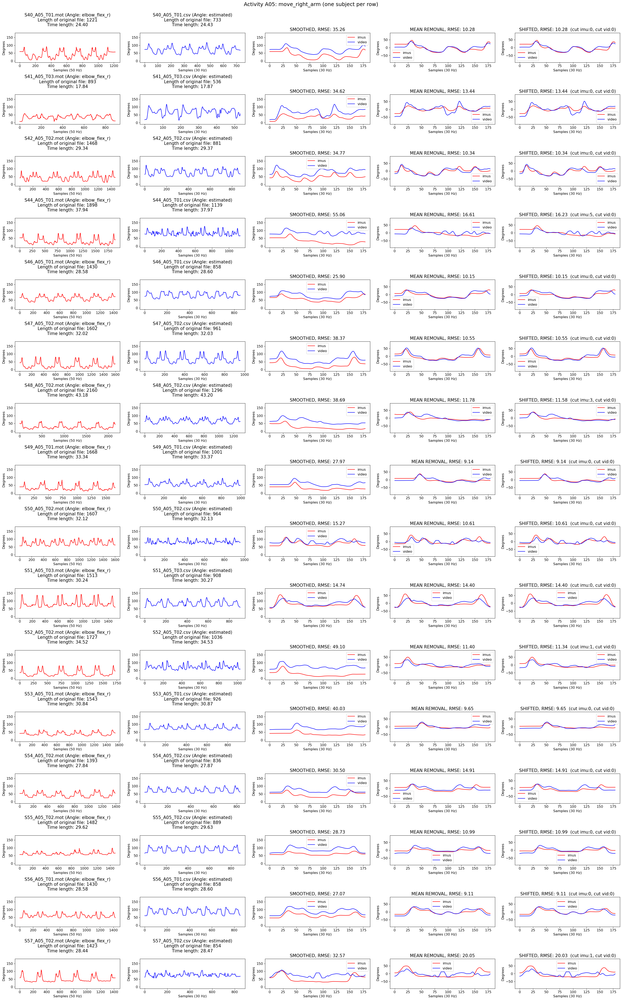

Activity: A06


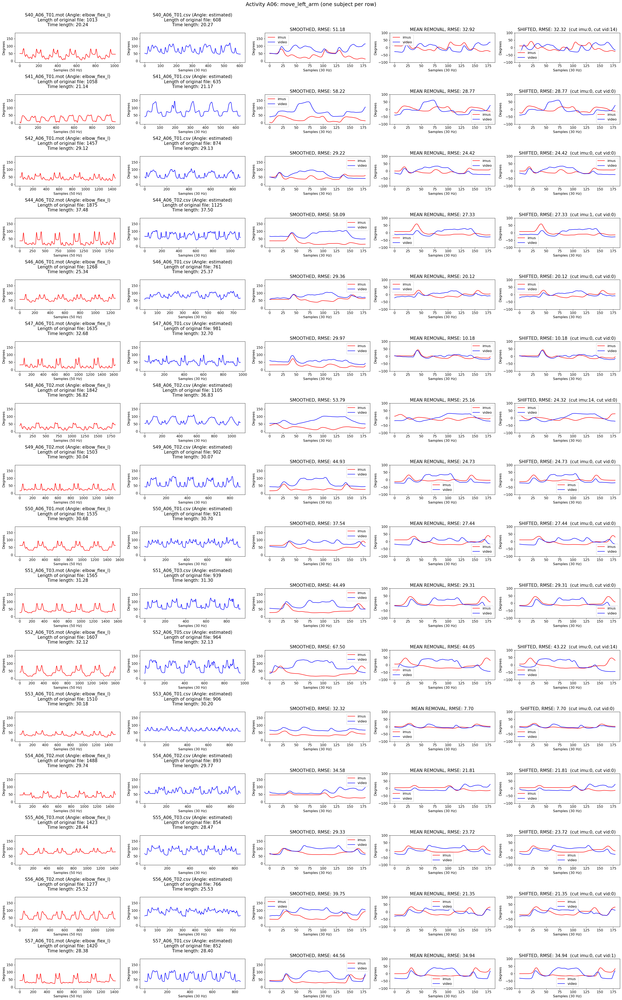

Activity: A07


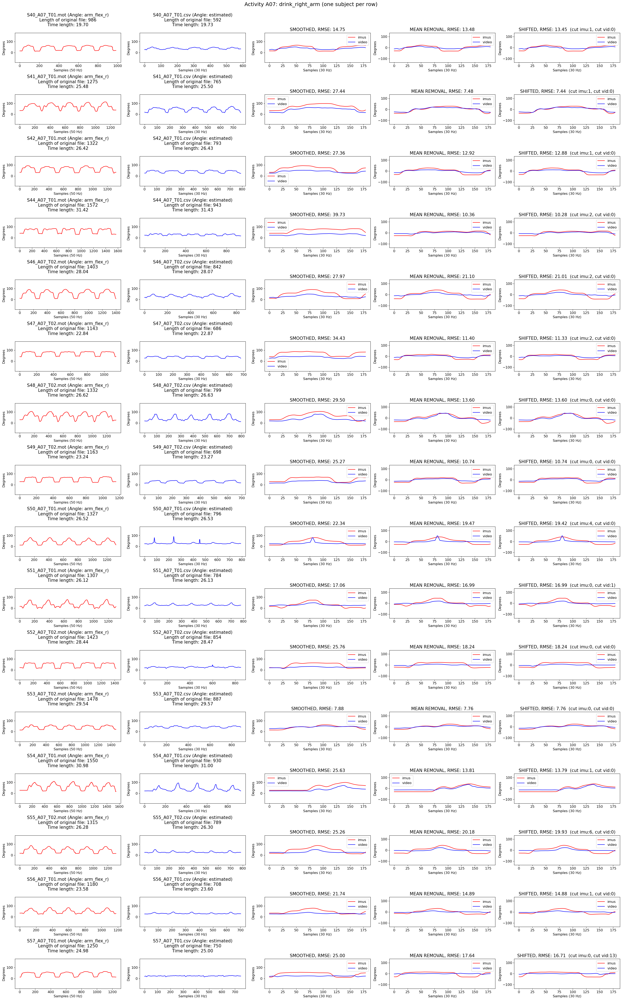

Activity: A08


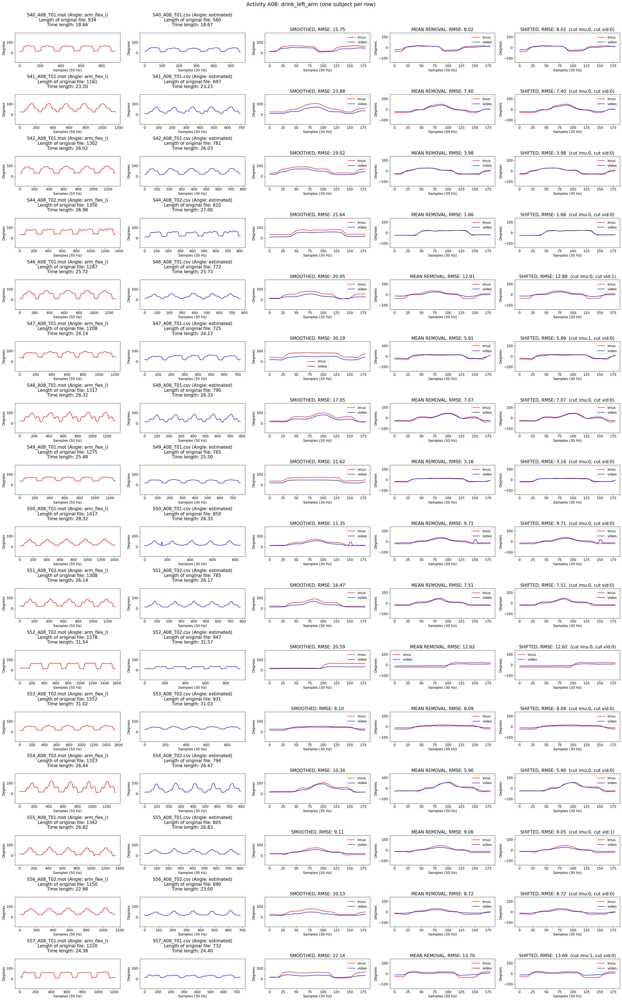

Activity: A09


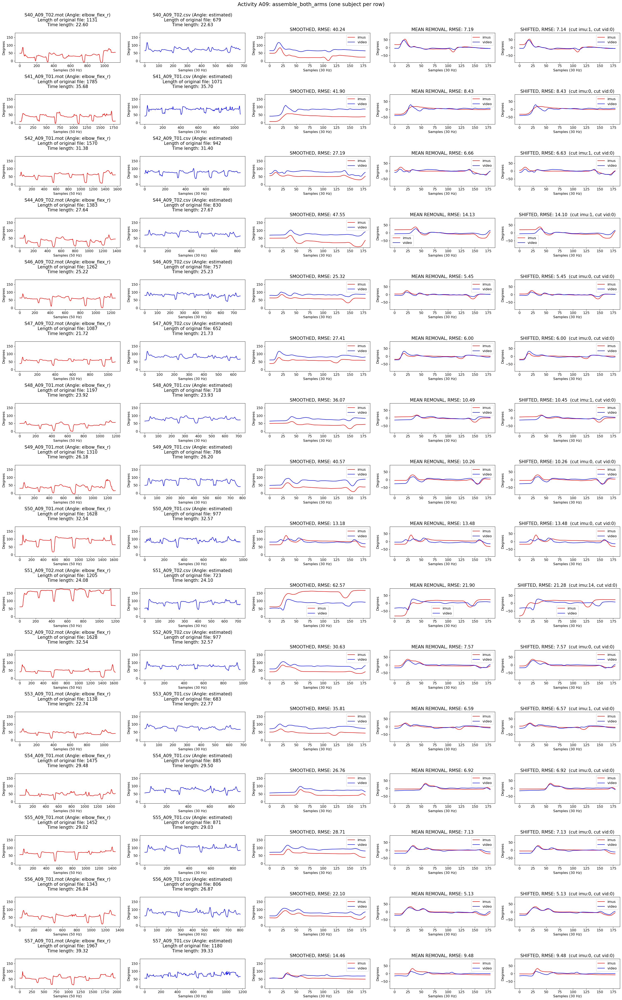

Activity: A10


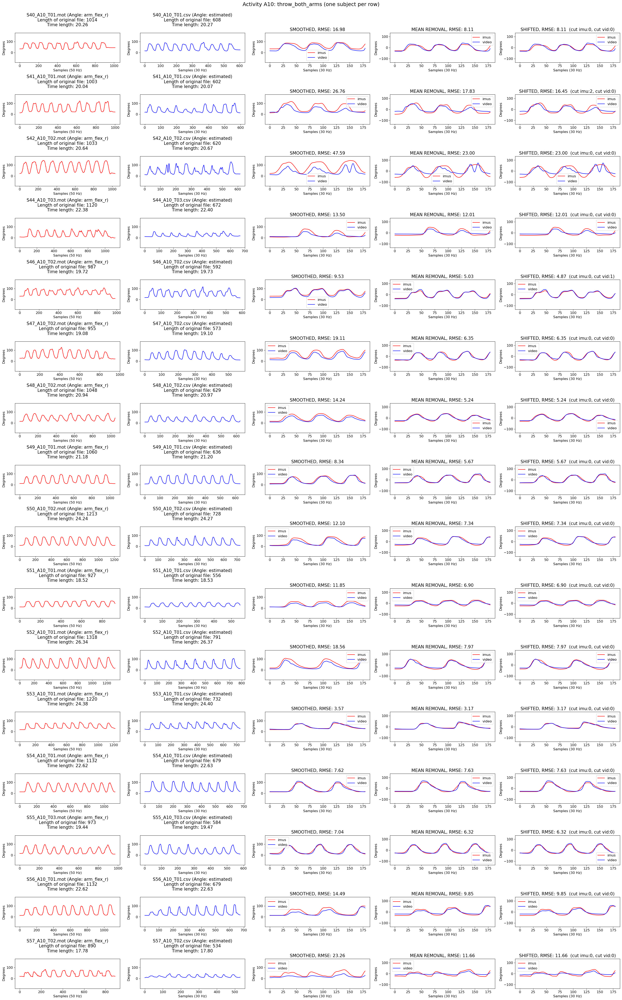

Activity: A11


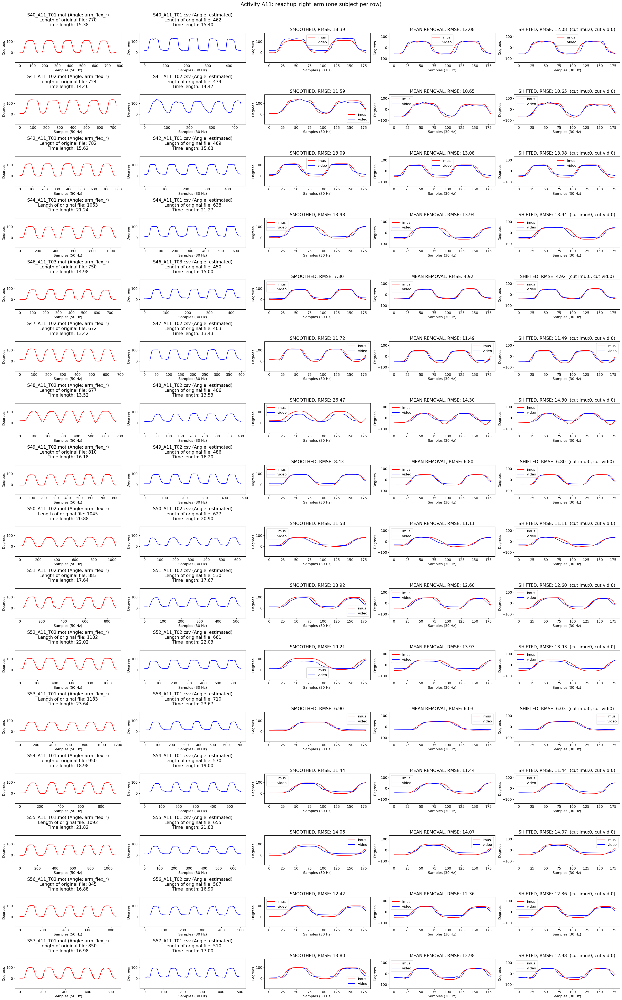

Activity: A12


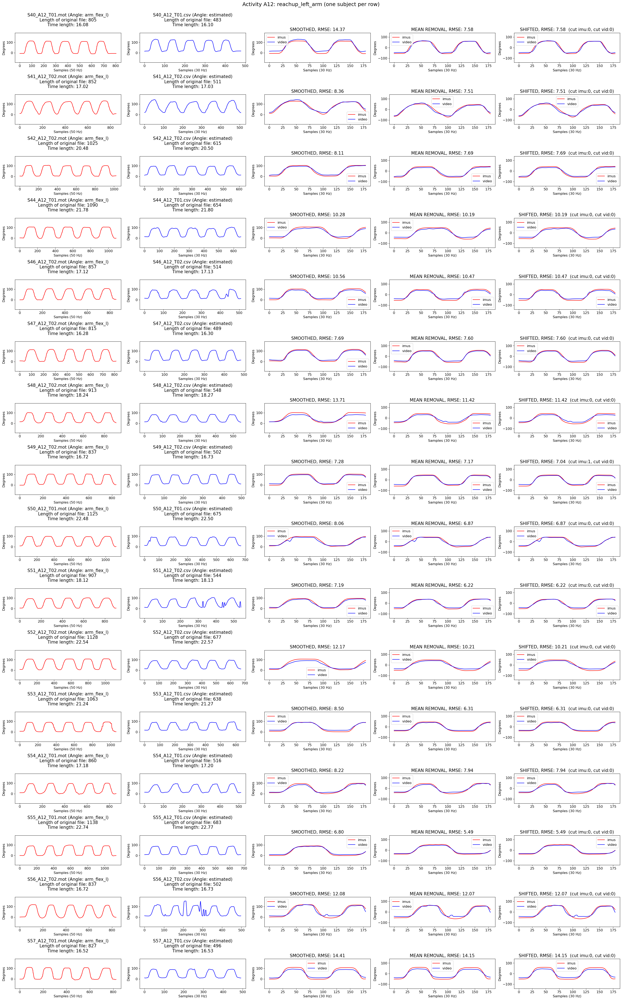

Activity: A13


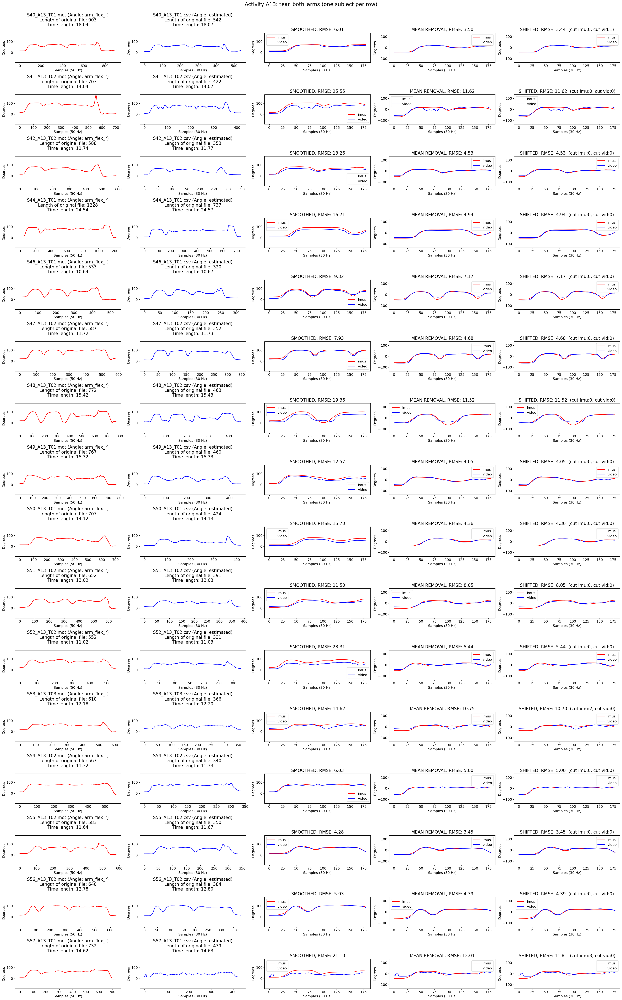

In [26]:
rmse_lists = []
index_activity = 0
outpath=None
csvlog = 'infoToSync.csv'
csvlogfile = None

inpath = croppath

RMSE_SAMPLES = 180
FINAL_LENGTH= 180
# FINAL_LENGTH= None
MAX_SYNC_OVERLAP = 15

for activity, legend in zip(dataset_activities, activities_legend):
    pass
    print("Activity: " + activity)
    rmse_list = plotFramesShiftToSyncrhonizeAllSubjectsOneActivity(csvlog, inpath, outpath, subjects, activity, legend, None, RMSE_SAMPLES=RMSE_SAMPLES, MAX_SYNC_OVERLAP=MAX_SYNC_OVERLAP, FINAL_LENGTH=FINAL_LENGTH)